## Import library

In [ ]:
import torch
import matplotlib.pyplot as plt

from glob import glob
from tqdm.auto import tqdm
from collections import defaultdict

from torch import nn
from torch.nn import functional as F
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from torchvision.utils import make_grid
from torch.utils.tensorboard import SummaryWriter
from torchsummary import summary

from sklearn.model_selection import train_test_split

from warnings import filterwarnings
filterwarnings("ignore",category=DeprecationWarning)
filterwarnings("ignore", category=FutureWarning) 
filterwarnings("ignore", category=UserWarning)
%matplotlib inline

### Download data

In [ ]:
!gdown --id 18CQK_JXSgVny-fSYFPv6qqy_lYeBfm0U
!unzip -q data_2.zip

Downloading...
From: https://drive.google.com/uc?id=18CQK_JXSgVny-fSYFPv6qqy_lYeBfm0U
To: /content/data_2.zip
100% 238M/238M [00:01<00:00, 173MB/s]


### Load data with PyTorch

In [ ]:
train_transform = transforms.Compose([
    transforms.RandomRotation(10),
    transforms.RandomHorizontalFlip(),
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

test_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

inv_normalize = transforms.Normalize(
    [-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
    [1 / 0.229, 1 / 0.224, 1 / 0.225])


def imshow(im):
    plt.figure(figsize=(10, 10))
    plt.imshow(im.numpy().transpose(1, 2, 0))

In [ ]:
train_dir = "./data_2/train/"
val_dir = "./data_2/valid/"
test_dir = "./data_2/test/"

train_ds = datasets.ImageFolder(root=train_dir, transform=train_transform)
val_ds = datasets.ImageFolder(root=val_dir, transform=train_transform)
test_ds = datasets.ImageFolder(root=test_dir, transform=test_transform)


In [ ]:
class_names = train_ds.classes
inv_class_names = train_ds.class_to_idx
print(f"Train set: {len(train_ds)} images")
print(f"Validation set: {len(val_ds)} images")
print(f"Test set: {len(test_ds)} images")

Train set: 3299 images
Validation set: 369 images
Test set: 649 images


### Visualize First Train Batch

Label: [4 4 4 1 1 4 0 1 3 4]
Class:  tulip tulip tulip dandelion dandelion tulip daisy dandelion sunflower tulip


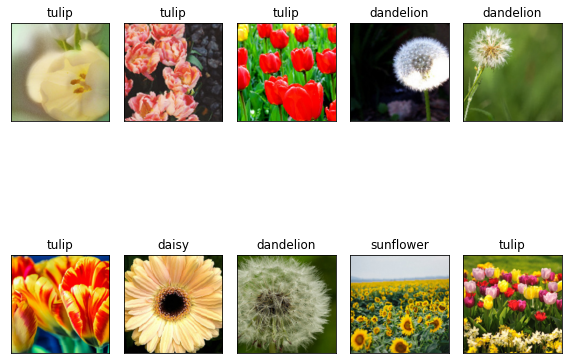

In [ ]:
for images, labels in DataLoader(train_ds, batch_size=10, shuffle=True):
    print(f"Label: {labels.numpy()}")
    print(f"Class: ", *[class_names[i] for i in labels])

    images = inv_normalize(images)
    fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(8, 8), subplot_kw={"xticks": [],"yticks": []})
    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i].numpy().transpose(1, 2, 0))
        ax.set_title(class_names[labels[i]])
    plt.tight_layout()
    plt.show()

    break


### Define CNN Model

In [ ]:
class CNN2(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, padding='same'),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=(2, 2))
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=5, padding='same'),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=(2, 2))
        )
        self.conv3 = nn.Sequential(
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=5, padding='same'),
            nn.ReLU(),
            nn.BatchNorm2d(num_features=64),
            nn.MaxPool2d(kernel_size=(2, 2))
        )
        self.conv4 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding='same'),
            nn.ReLU(),
            nn.BatchNorm2d(num_features=128),
            nn.MaxPool2d(kernel_size=(2, 2))
        )
        self.conv5 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding='same'),
            nn.ReLU(),
            nn.BatchNorm2d(num_features=256),
            nn.MaxPool2d(kernel_size=(2, 2))
        )
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(in_features=7*7*256, out_features=512),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(in_features=512, out_features=128),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(in_features=128, out_features=64),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(in_features=64, out_features=5),
            nn.LogSoftmax(dim=1)
        )

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)
        x = self.classifier(x)

        return x

In [ ]:
summary(CNN2(), (3, 224, 224), batch_size=1, device="cpu")

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [1, 16, 224, 224]             448
              ReLU-2          [1, 16, 224, 224]               0
         MaxPool2d-3          [1, 16, 112, 112]               0
            Conv2d-4          [1, 32, 112, 112]          12,832
              ReLU-5          [1, 32, 112, 112]               0
         MaxPool2d-6            [1, 32, 56, 56]               0
            Conv2d-7            [1, 64, 56, 56]          51,264
              ReLU-8            [1, 64, 56, 56]               0
       BatchNorm2d-9            [1, 64, 56, 56]             128
        MaxPool2d-10            [1, 64, 28, 28]               0
           Conv2d-11           [1, 128, 28, 28]          73,856
             ReLU-12           [1, 128, 28, 28]               0
      BatchNorm2d-13           [1, 128, 28, 28]             256
        MaxPool2d-14           [1, 128,

### Train model

In [ ]:
def calc_accuracy(output, target):
    _, predicted = torch.max(output, dim=1)
    correct = int((predicted == target).sum().item())
    return torch.true_divide(correct, output.size(0)).item()

In [ ]:
class MetricMonitor:
    def __init__(self, float_precision=3):
        self.float_precision = float_precision
        self.reset()

    def reset(self):
        self.metrics = defaultdict(lambda: {"val": 0, "count": 0, "avg": 0})

    def update(self, metric_name, val):
        metric = self.metrics[metric_name]

        metric["val"] += val
        metric["count"] += 1
        metric["avg"] = metric["val"] / metric["count"]

    def __str__(self):
        return " | ".join(
            [
                "{metric_name}: {avg:.{float_precision}f}".format(
                    metric_name=metric_name, avg=metric["avg"], float_precision=self.float_precision
                )
                for (metric_name, metric) in self.metrics.items()
            ]
        )

In [ ]:
cls_model = CNN2()

params = {
    "batch_size": 32,
    "num_workers": 0,
    "epochs":5,
    "lr": 0.001,
    "device": "cuda" if torch.cuda.is_available() else "cpu",
}

params.update({
    "loss_fn": nn.NLLLoss(),
    "optimzer": torch.optim.Adam(cls_model.parameters(), lr=params['lr'])
})

train_loader = DataLoader(train_ds, batch_size=params['batch_size'], shuffle=True, num_workers=params['num_workers'], pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=params['batch_size'], num_workers=params['num_workers'], pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=params['batch_size'], num_workers=params['num_workers'], pin_memory=True)

# 
tb = SummaryWriter()
images, labels = next(iter(train_loader))
grid = make_grid(images)
tb.add_image("images", grid)
tb.add_graph(cls_model, images)
tb.close()

In [ ]:
train_hist = {
    "train_loss": [],
    "train_acc": [],
    "val_loss":[],
    "val_acc": []
}

def training_loops(n_epochs, model, train_loader, val_loader, optimizer, loss_fn, device='cpu'):
    tb = SummaryWriter()
    # 
    for epoch in range(n_epochs):

        # training phase
        model.train()
        train_metric = MetricMonitor()
        correct = 0
        total = 0
        running_loss = 0
        train_stream = tqdm(train_loader)
        for imgs, labels in train_stream:
            imgs = imgs.to(device, non_blocking=True)
            labels = labels.to(device, non_blocking=True)
            # inference
            pred = model(imgs)
            loss = loss_fn(pred, labels)
            # 
            running_loss += loss.item()
            total += labels.size(0)
            correct += pred.argmax(dim=1).eq(labels).sum().item()
            # optimzer
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            train_metric.update("Loss", loss.item())
            train_metric.update("Accuracy", calc_accuracy(pred, labels))
            train_stream.set_description(f"Epoch: {epoch+1}/{n_epochs}. Train.      {train_metric}")
        
        tb.add_scalar("Train Loss", running_loss / len(val_loader), epoch)
        tb.add_scalar("Train acc", correct/total, epoch)
        train_hist['train_loss'].append(running_loss / len(train_loader))
        train_hist['train_acc'].append(correct/total)

        # validation phase
        model.eval()
        val_metric = MetricMonitor()
        correct = 0
        total = 0
        running_loss = 0
        val_stream = tqdm(val_loader)
        with torch.no_grad():
            for imgs, labels in val_stream:
                imgs = imgs.to(device, non_blocking=True)
                labels = labels.to(device, non_blocking=True)
                # inference
                pred = model(imgs)
                loss = loss_fn(pred, labels)
                # 
                running_loss += loss.item()
                total += labels.size(0)
                correct += pred.argmax(dim=1).eq(labels).sum().item()
                # 
                val_metric.update("Loss", loss.item())
                val_metric.update("Accuracy", calc_accuracy(pred, labels))
                val_stream.set_description(f"Epoch: {epoch+1}/{n_epochs}. Valid.      {train_metric}")

        tb.add_scalar("Validation Loss", running_loss / len(val_loader), epoch)
        tb.add_scalar("Validation Acc", correct/total, epoch)        
        train_hist['val_loss'].append(running_loss / len(val_loader))
        train_hist['val_acc'].append(correct/total)
    tb.close()

In [ ]:
cls_model.train()
cls_model.to(params['device'])
training_loops(n_epochs=params['epochs'], 
               model=cls_model, 
               train_loader=train_loader,
                val_loader=val_loader,
               optimizer=params['optimzer'], 
               loss_fn=params['loss_fn'],
               device=params['device'])

  0%|          | 0/104 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/104 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/104 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/104 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/104 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

### Visualize Training results

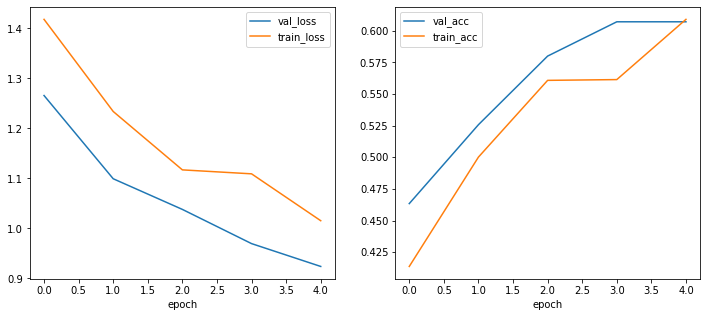

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
axes = axes.flat
metrics_name = (("val_loss", "train_loss"),("val_acc", "train_acc"))

for i, ax in enumerate(axes):
    metric = metrics_name[i]
    ax.plot(train_hist[metric[0]], label=metric[0])
    ax.plot(train_hist[metric[1]], label=metric[1])
    ax.set_xlabel("epoch")
    ax.legend()

plt.show()

### Measuring Accuracy

In [ ]:
def validate(model, train_loader, test_loader, device="cpu"):
    for name, loader in [("train", train_loader), ("test", test_loader)]:
        correct = 0
        total = 0

        with torch.no_grad():
            test_stream = tqdm(loader)
            for imgs, labels in test_stream:
                imgs = imgs.to(device)
                labels = labels.to(device)

                outputs = model(imgs)
                total += labels.shape[0]
                correct += outputs.argmax(dim=1).eq(labels).sum().item()

            print(f"Accuracy {name}: {100*correct/total:3f} %")

In [ ]:
validate(cls_model, train_loader, test_loader, device=params['device'])

  0%|          | 0/104 [00:00<?, ?it/s]

Accuracy train: 63.291907 %


  0%|          | 0/21 [00:00<?, ?it/s]

Accuracy test: 63.790447 %


### Save model

In [ ]:
torch.save(cls_model.state_dict(), "flower_cls.pt")

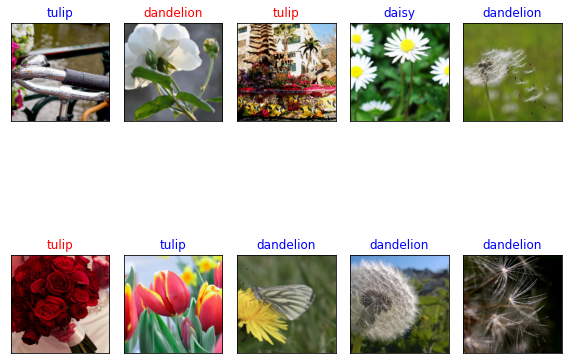

In [ ]:
cls_model.eval()
with torch.no_grad():
    for imgs, labels in DataLoader(test_ds, batch_size=10, shuffle=True):
        # to device
        imgs = imgs.to(params['device'])
        labels = labels.to(params['device'])
        
        # get the output
        outputs = cls_model(imgs)
        _, predicted = torch.max(outputs, dim=1)

        # plot results
        imgs = imgs.cpu()
        imgs = inv_normalize(imgs)

        fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(5, 8), subplot_kw={"xticks": [],"yticks": []})
        for i, ax in enumerate(axes.flat):
            ax.imshow(imgs[i].numpy().transpose(1, 2, 0))

            truth_label = class_names[labels[i]]
            predicted_label = class_names[predicted[i]]
            color = "blue" if truth_label == predicted_label else "red"
            ax.set_title(predicted_label, color=color)
        
        plt.tight_layout()
        plt.show()
        break